<a href="https://colab.research.google.com/github/dominiquebuford/CV_individualproject/blob/main/CV_trainingDetectron2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
#grab data from Google drive and sort back into train and val folders
import os

images_path = "/content/drive/MyDrive/CV_individualproject/images"

images = os.listdir(images_path)

train_images_path = "/content/train_images"
val_images_path = "/content/val_images"

os.makedirs(train_images_path, exist_ok=True)
os.makedirs(val_images_path, exist_ok=True)

for image in images:
  pathToCheck = "data/obj/"+image
  oldPath = os.path.join(images_path, image)
  with open("/content/drive/MyDrive/CV_individualproject/train.txt", 'r') as file:
        file_content = file.read()
        if pathToCheck in file_content:
          newPath = os.path.join(train_images_path, image)
        else:
          newPath = os.path.join(val_images_path, image)
  os.system(f'cp {oldPath} {newPath}')



In [2]:
# Install detectron2
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-9yaqzsz4
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-9yaqzsz4
  Resolved https://github.com/facebookresearch/detectron2.git to commit cc9266c2396d5545315e3601027ba4bc28e8c95b
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 3.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 9.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 15.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 59.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 16.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for detectron2: filename=detectron2-0.6-cp310-cp310-linux_x86_64.whl size=6123039 sha256=9da398be9991c02cea9edf729321

In [3]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Tue_Aug_15_22:02:13_PDT_2023
Cuda compilation tools, release 12.2, V12.2.140
Build cuda_12.2.r12.2/compiler.33191640_0
torch:  2.1 ; cuda:  cu121
detectron2: 0.6


In [4]:
!pip install torchvision

In [5]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
import torchvision
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [6]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/drive/MyDrive/CV_individualproject/train_coco_annotations.json", "/content/train_images")
register_coco_instances("my_dataset_val", {}, "/content/drive/MyDrive/CV_individualproject/validation_coco_annotations.json", "/content/val_images")
register_coco_instances("my_dataset_test", {}, "/content/drive/MyDrive/CV_individualproject/test_coco_annotations.json", "/content/drive/MyDrive/CV_individualproject/images_test")

[03/12 23:25:56 d2.data.datasets.coco]: Loaded 256 images in COCO format from /content/drive/MyDrive/CV_individualproject/train_coco_annotations.json


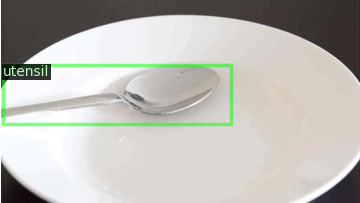

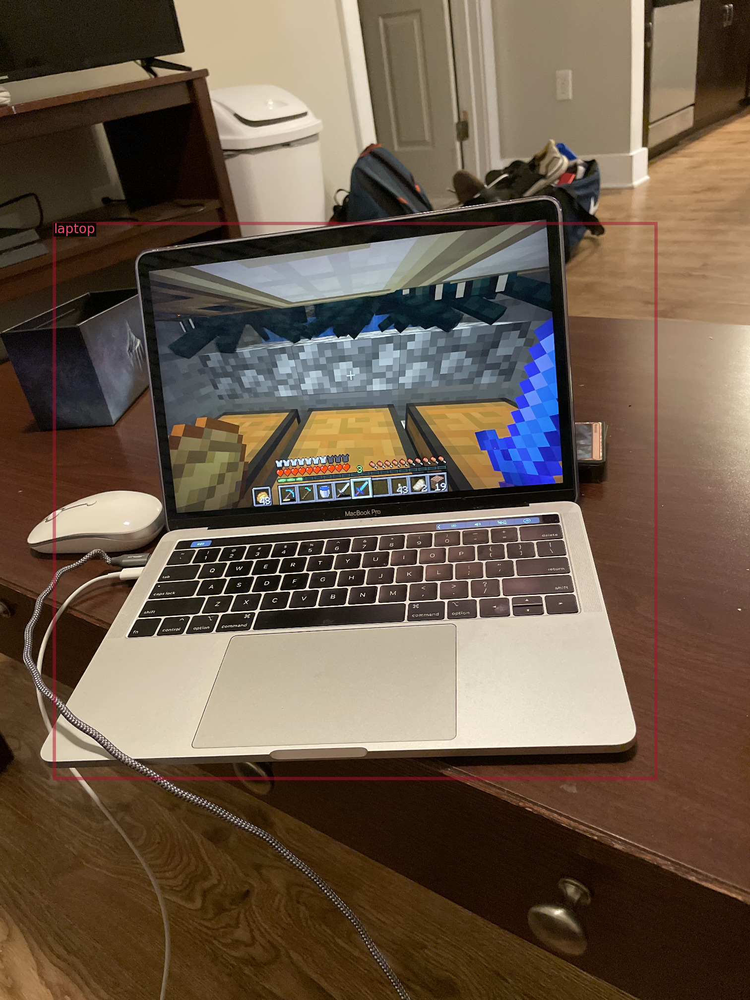

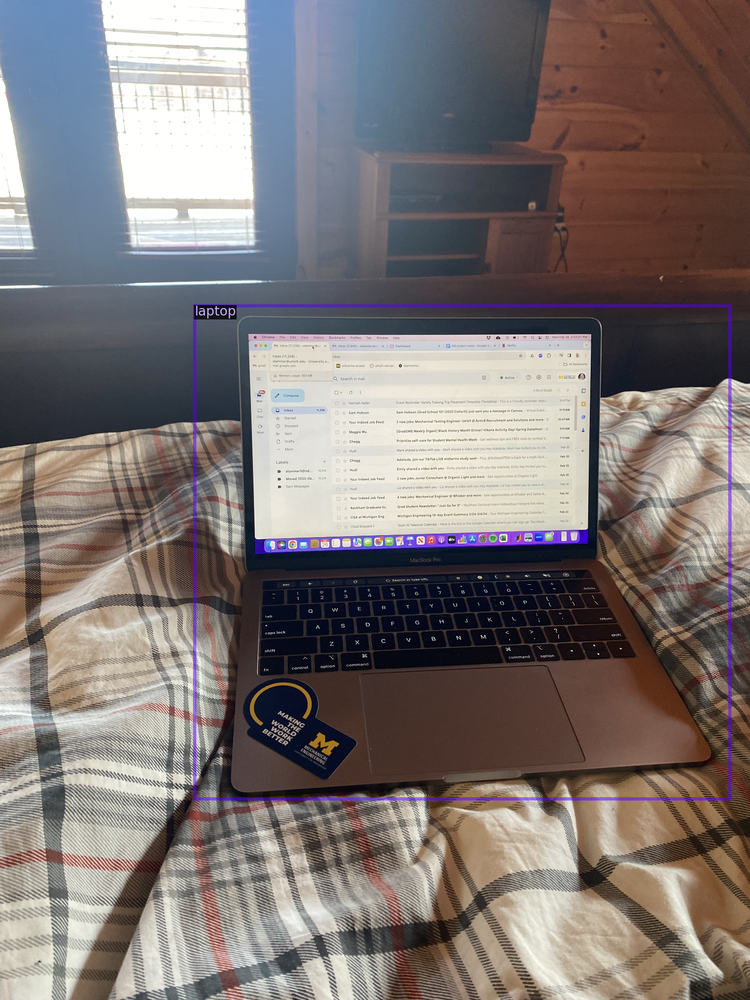

In [7]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [8]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.01 #from 0.001


cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 2000
cfg.SOLVER.STEPS = (200, 500, 1500)
cfg.SOLVER.GAMMA = 0.05

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3

cfg.TEST.EVAL_PERIOD = 500

In [9]:
from detectron2.data import detection_utils as utils
import detectron2.data.transforms as T
import copy

def custom_mapper(dataset_dict):
  image = utils.read_image(dataset_dict["file_name"], format="BGR")
  transform_list = [
      T.Resize((800,600)),
      T.RandomBrightness(0.8, 1.8),
      T.RandomContrast(0.6, 1.3),
      T.RandomSaturation(0.8, 1.4),
      T.RandomRotation(angle=[90, 90]),
      T.RandomLighting(0.7),
      T.RandomFlip(prob=0.4, horizontal=False, vertical=True),
  ]
  image, transforms = T.apply_transform_gens(transform_list, image)
  dataset_dict["image"] = torch.as_tensor(image.transpose(2, 0, 1).astype("float32"))

  annos = [
      utils.transform_instance_annotations(obj, transforms, image.shape[:2])
      for obj in dataset_dict.pop("annotations")
      if obj.get("iscrowd", 0) == 0
  ]
  instances = utils.annotations_to_instances(annos, image.shape[:2])
  dataset_dict["instances"] = utils.filter_empty_instances(instances)
  return dataset_dict

In [10]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator
from detectron2.data import build_detection_train_loader

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

  @classmethod
  def build_train_loader(cls, cfg):
        return build_detection_train_loader(cfg, mapper=custom_mapper)


In [11]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok = True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume = False)
trainer.train()

[03/12 23:26:09 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
model_final_68b088.pkl: 421MB [00:03, 140MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[03/12 23:26:12 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3526.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[03/12 23:27:02 d2.utils.events]:  eta: 0:54:48  iter: 19  total_loss: 2.412  loss_cls: 1.466  loss_box_reg: 0.877  loss_rpn_cls: 0.03018  loss_rpn_loc: 0.0151    time: 1.7992  last_time: 1.2730  data_time: 1.0965  last_data_time: 0.1674   lr: 1.0285e-05  max_mem: 5445M
[03/12 23:27:46 d2.utils.events]:  eta: 0:51:05  iter: 39  total_loss: 2.291  loss_cls: 1.333  loss_box_reg: 0.9218  loss_rpn_cls: 0.0245  loss_rpn_loc: 0.01199    time: 1.8422  last_time: 1.1743  data_time: 0.9354  last_data_time: 0.0700   lr: 1.0585e-05  max_mem: 5445M
[03/12 23:28:24 d2.utils.events]:  eta: 0:51:57  iter: 59  total_loss: 2.16  loss_cls: 1.186  loss_box_reg: 0.948  loss_rpn_cls: 0.03921  loss_rpn_loc: 0.01373    time: 1.8601  last_time: 1.5886  data_time: 0.9669  last_data_time: 0.6154   lr: 1.0885e-05  max_mem: 5445M
[03/12 23:29:02 d2.utils.events]:  eta: 0:52:50  iter: 79  total_loss: 2.123  loss_cls: 1.094  loss_box_reg: 0.9542  loss_rpn_cls: 0.03804  loss_rpn_loc: 0.01787    time: 1.8691  last_ti

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[03/12 23:42:18 d2.evaluation.evaluator]: Inference done 11/33. Dataloading: 0.0899 s/iter. Inference: 0.2148 s/iter. Eval: 0.0005 s/iter. Total: 0.3051 s/iter. ETA=0:00:06
[03/12 23:42:23 d2.evaluation.evaluator]: Inference done 25/33. Dataloading: 0.1369 s/iter. Inference: 0.2256 s/iter. Eval: 0.0009 s/iter. Total: 0.3642 s/iter. ETA=0:00:02
[03/12 23:42:26 d2.evaluation.evaluator]: Total inference time: 0:00:10.016680 (0.357739 s / iter per device, on 1 devices)
[03/12 23:42:26 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:05 (0.202943 s / iter per device, on 1 devices)
[03/12 23:42:26 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[03/12 23:42:26 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[03/12 23:42:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.01s)
creating index...
index created!
[03/12 23:42:26 d2.evaluation.

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[03/12 23:58:10 d2.evaluation.evaluator]: Inference done 11/33. Dataloading: 0.1472 s/iter. Inference: 0.1367 s/iter. Eval: 0.0005 s/iter. Total: 0.2844 s/iter. ETA=0:00:06
[03/12 23:58:15 d2.evaluation.evaluator]: Inference done 21/33. Dataloading: 0.2590 s/iter. Inference: 0.1583 s/iter. Eval: 0.0017 s/iter. Total: 0.4199 s/iter. ETA=0:00:05
[03/12 23:58:19 d2.evaluation.evaluator]: Total inference time: 0:00:11.095708 (0.396275 s / iter per device, on 1 devices)
[03/12 23:58:19 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:04 (0.156049 s / iter per device, on 1 devices)
[03/12 23:58:20 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[03/12 23:58:20 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[03/12 23:58:20 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.01s)
creating index...
index created!
[03/12 23:58:20 d2.evaluation.

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[03/13 00:14:05 d2.evaluation.evaluator]: Inference done 11/33. Dataloading: 0.2205 s/iter. Inference: 0.1995 s/iter. Eval: 0.0023 s/iter. Total: 0.4223 s/iter. ETA=0:00:09
[03/13 00:14:10 d2.evaluation.evaluator]: Inference done 21/33. Dataloading: 0.2750 s/iter. Inference: 0.2141 s/iter. Eval: 0.0023 s/iter. Total: 0.4917 s/iter. ETA=0:00:05
[03/13 00:14:14 d2.evaluation.evaluator]: Total inference time: 0:00:11.208447 (0.400302 s / iter per device, on 1 devices)
[03/13 00:14:14 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:04 (0.174276 s / iter per device, on 1 devices)
[03/13 00:14:14 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[03/13 00:14:14 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[03/13 00:14:14 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[03/13 00:14:14 d2.evaluation.

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[03/13 00:30:00 d2.evaluation.evaluator]: Inference done 11/33. Dataloading: 0.1312 s/iter. Inference: 0.1320 s/iter. Eval: 0.0004 s/iter. Total: 0.2636 s/iter. ETA=0:00:05
[03/13 00:30:06 d2.evaluation.evaluator]: Inference done 25/33. Dataloading: 0.2236 s/iter. Inference: 0.1602 s/iter. Eval: 0.0011 s/iter. Total: 0.3852 s/iter. ETA=0:00:03
[03/13 00:30:08 d2.evaluation.evaluator]: Total inference time: 0:00:09.395492 (0.335553 s / iter per device, on 1 devices)
[03/13 00:30:08 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:04 (0.146080 s / iter per device, on 1 devices)
[03/13 00:30:08 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[03/13 00:30:08 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[03/13 00:30:08 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[03/13 00:30:08 d2.evaluation.

In [12]:
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
results = inference_on_dataset(trainer.model, val_loader, evaluator)

[03/13 00:30:11 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
WARNING [03/13 00:30:11 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[03/13 00:30:12 d2.data.datasets.coco]: Loaded 31 images in COCO format from /content/drive/MyDrive/CV_individualproject/test_coco_annotations.json
[03/13 00:30:12 d2.data.build]: Distribution of instances among all 3 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|:----------:|:-------------|
|   drink    | 28           |   laptop   | 13           |  utensil   | 26           |
|            |              |            |              |            |              |
|   total    | 67           |            |              |            |              |
[03/13 00:30:12 d2.data.dataset_mapper]: [DatasetMa

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[03/13 00:30:17 d2.evaluation.evaluator]: Inference done 11/31. Dataloading: 0.1070 s/iter. Inference: 0.1383 s/iter. Eval: 0.0005 s/iter. Total: 0.2458 s/iter. ETA=0:00:04
[03/13 00:30:24 d2.evaluation.evaluator]: Inference done 21/31. Dataloading: 0.3537 s/iter. Inference: 0.1455 s/iter. Eval: 0.0005 s/iter. Total: 0.5002 s/iter. ETA=0:00:05
[03/13 00:30:28 d2.evaluation.evaluator]: Total inference time: 0:00:12.736623 (0.489870 s / iter per device, on 1 devices)
[03/13 00:30:28 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:03 (0.133454 s / iter per device, on 1 devices)
[03/13 00:30:28 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[03/13 00:30:28 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[03/13 00:30:28 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[03/13 00:30:28 d2.evaluation.f

In [13]:
%load_ext tensorboard
log_dir = '/content/output'
%tensorboard --logdir {log_dir}

<IPython.core.display.Javascript object>

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


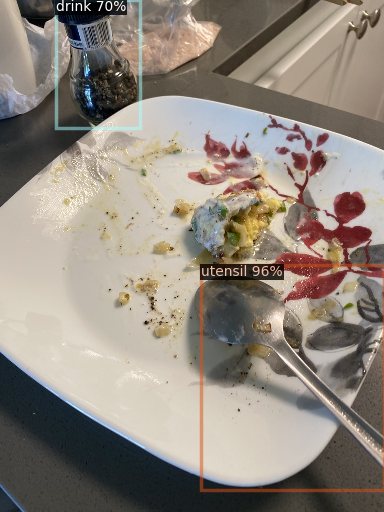

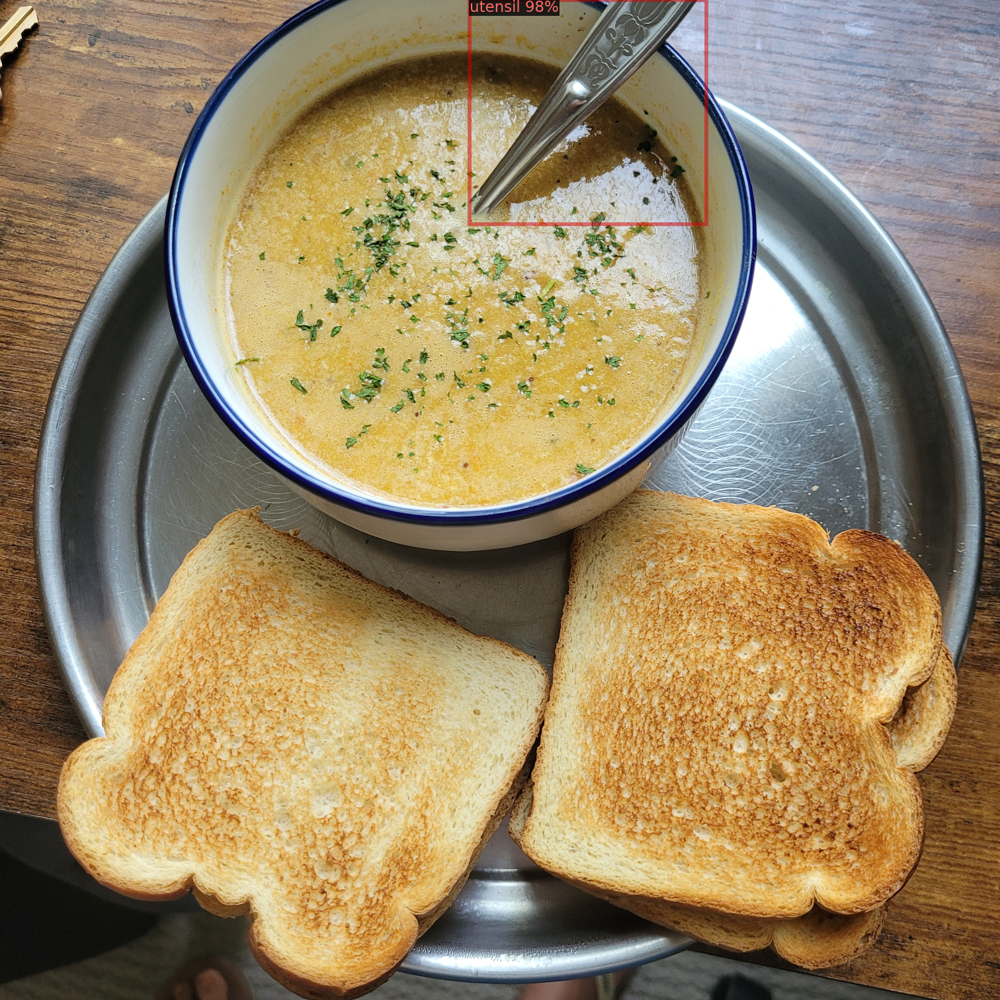

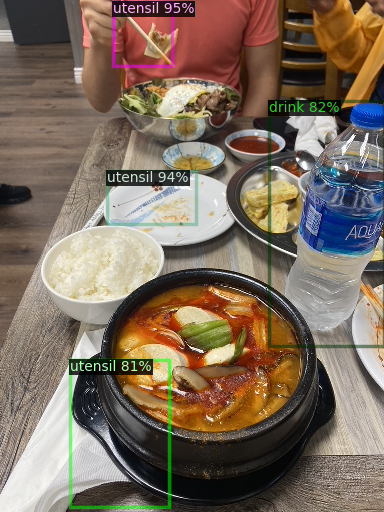

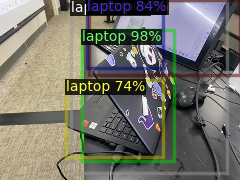

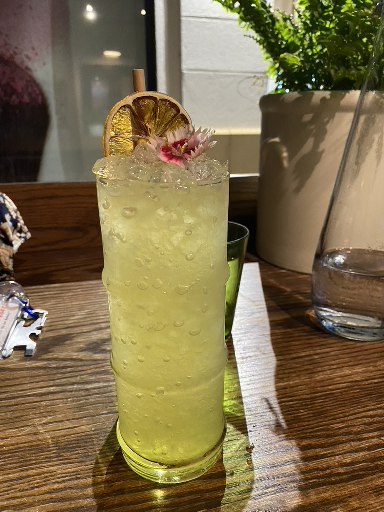

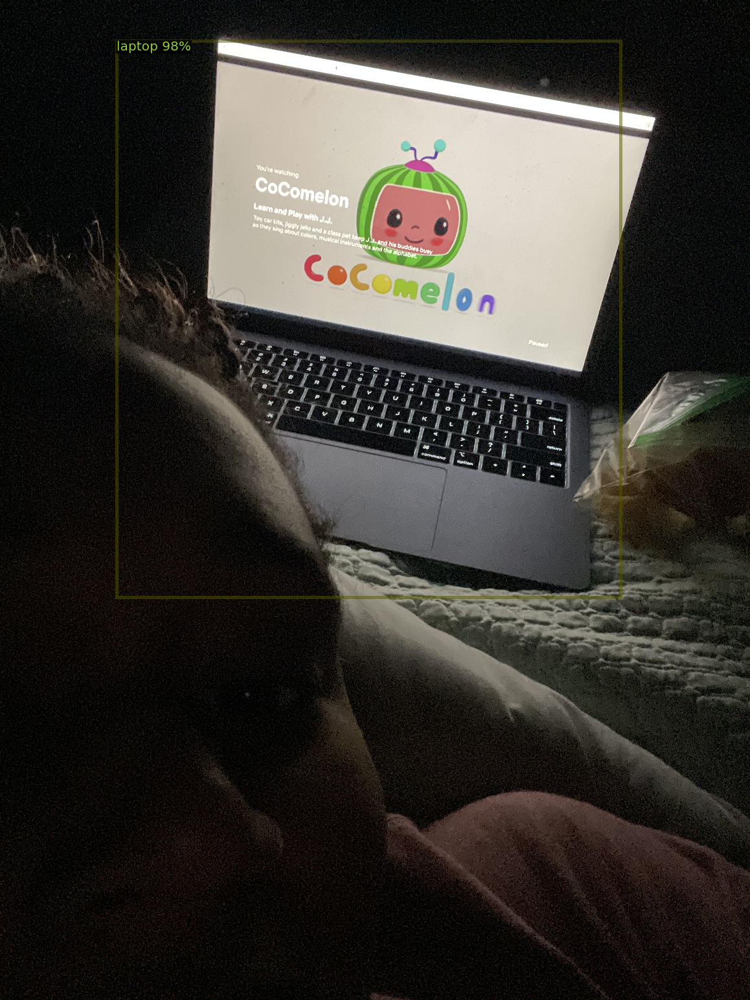

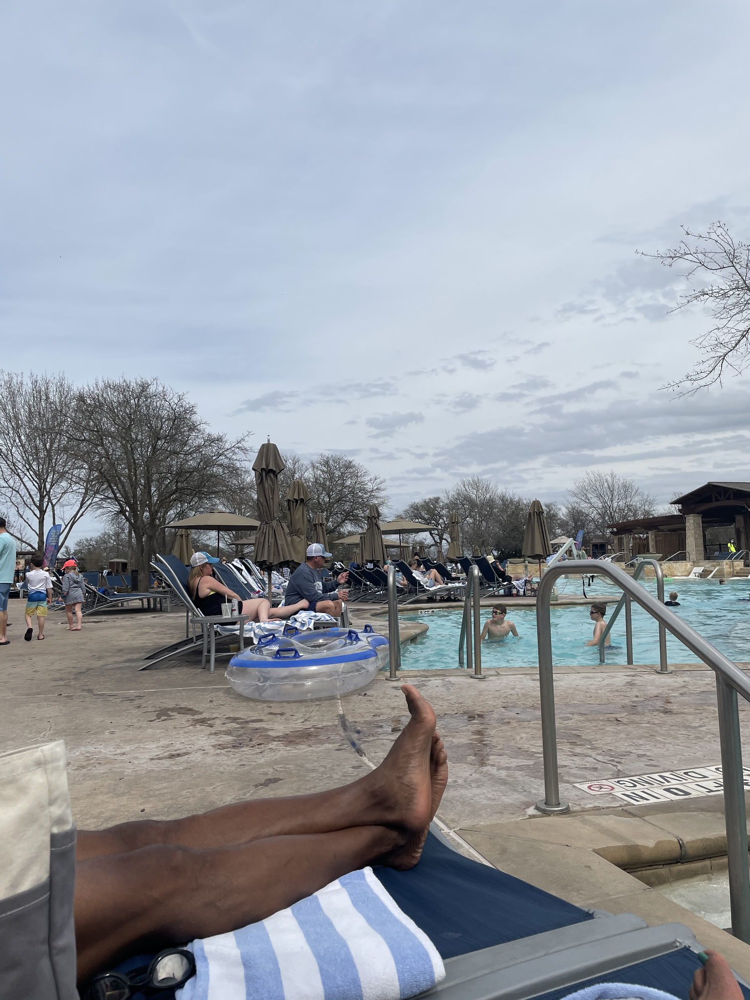

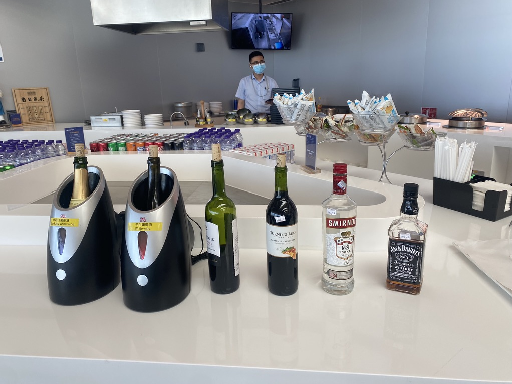

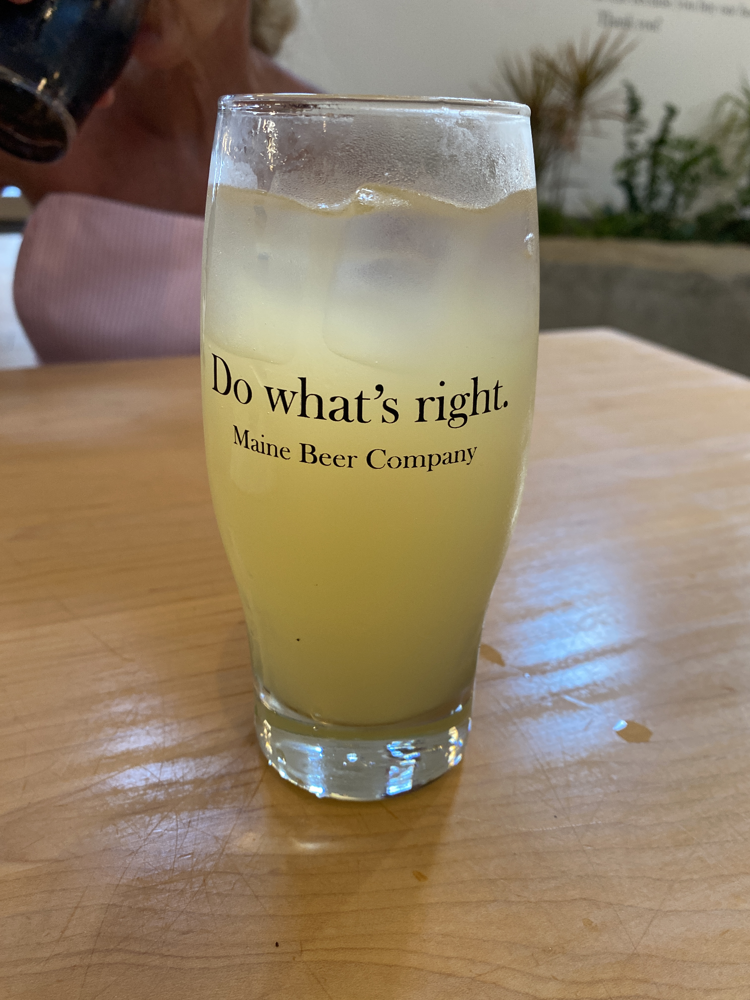

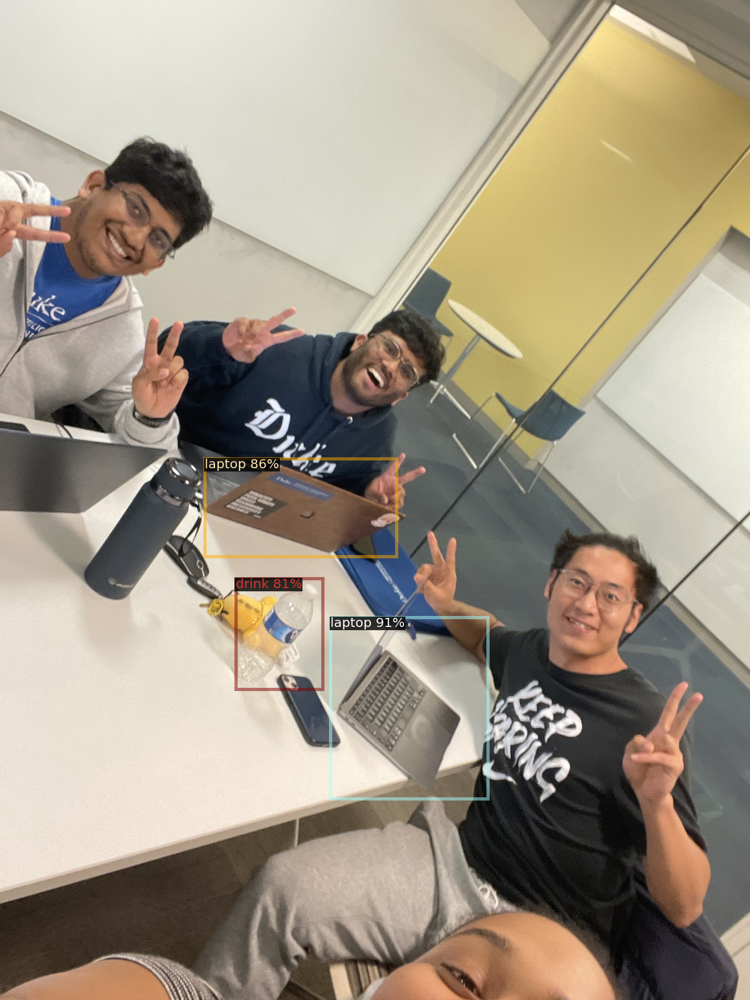

In [ ]:
from detectron2.utils.visualizer import Visualizer

# Visualize predictions for a few images
for i, input_data in enumerate(val_loader):
  image = cv2.imread(input_data[0]["file_name"])
  outputs = predictor(image)

  v = Visualizer(image[:, :, ::-1], metadata=MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=0.5)
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

  cv2_imshow(out.get_image()[:, :, ::-1])
  cv2.waitKey(0)
  cv2.destroyAllWindows()

